In [336]:
import json
from collections import defaultdict
from decimal import Decimal, ROUND_DOWN
import os




def ensure_valid_gzip(filename):
    """
    Garante que o arquivo gzip seja válido. Se não existir, cria um arquivo inicial vazio compactado.
    """
    if not os.path.exists(filename):
        # Cria um arquivo gzip vazio contendo uma lista
        with gzip.open(filename, "wt") as f:
            json.dump([], f)


def load_existing_data(filename):
    """
    Carrega os dados existentes de um arquivo compactado gzip.
    """
    try:
        with gzip.open(filename, "rt") as f:
            return json.load(f)
    except (OSError, json.JSONDecodeError):
        print(f"Erro ao carregar o arquivo {filename}. Inicializando como lista vazia.")
        return []



def load_existing_data(filename):
    """
    Carrega os dados existentes de um arquivo compactado gzip.
    """
    try:
        with open(filename) as f:
            return json.load(f)
    except (OSError, json.JSONDecodeError):
        print(f"Erro ao carregar o arquivo {filename}. Inicializando como lista vazia.")
        return []


def group_orderbook_by_tick(orderbook_snapshots, tick_size):
    """
    Processa o JSON do orderbook e agrupa os preços por um tick size especificado.

    :param orderbook_snapshots: Lista de snapshots do orderbook.
    :param tick_size: Tamanho do tick (ex.: 0.01, 0.001, 0.0001).
    :return: Lista de snapshots agrupados pelo tick size.
    """
    tick_size = Decimal(str(tick_size))  # Garantir precisão com decimal
    grouped_snapshots = []

    for snapshot in orderbook_snapshots:
        grouped_snapshot = {
            "timestamp": snapshot["timestamp"],
            "bids": _group_prices(snapshot["bids"], tick_size),
            "asks": _group_prices(snapshot["asks"], tick_size)
        }
        grouped_snapshots.append(grouped_snapshot)
    
    return grouped_snapshots


def _group_prices(prices, tick_size):
    """
    Agrupa preços de bids ou asks por um tick size especificado.

    :param prices: Lista de preços e quantidades (ex.: [["0.0320400", "10245"], ...]).
    :param tick_size: Tamanho do tick (ex.: 0.01, 0.001, 0.0001).
    :return: Lista agrupada de preços e quantidades.
    """
    grouped = defaultdict(Decimal)

    for price, quantity in prices:
        # Arredonda o preço para o tick size
        rounded_price = (Decimal(price) // tick_size) * tick_size
        # Soma a quantidade no preço arredondado
        grouped[rounded_price] += Decimal(quantity)
    
    # Retorna o resultado como uma lista ordenada
    return [[str(price), str(quantity)] for price, quantity in sorted(grouped.items())]



In [337]:
filename = "futures_orderbook_history_2.json"

# Carrega os dados existentes
existing_data = load_existing_data(filename)


# Agrupar bids e asks com tick size de 0.01
tick_size = 0.00001
grouped = group_orderbook_by_tick(existing_data, tick_size)

snapshots = grouped[3050:]


In [338]:
len(snapshots)

9136

In [339]:
snapshots[-1]

{'timestamp': '2024-12-24T10:56:59.287699',
 'bids': [['0.03156', '400064'],
  ['0.03157', '1573'],
  ['0.03158', '39155'],
  ['0.03159', '468468'],
  ['0.03160', '225707'],
  ['0.03161', '300239'],
  ['0.03162', '154810'],
  ['0.03164', '348'],
  ['0.03166', '179100'],
  ['0.03167', '331'],
  ['0.03168', '167879'],
  ['0.03169', '190048'],
  ['0.03170', '37854'],
  ['0.03171', '202321'],
  ['0.03172', '22068'],
  ['0.03173', '11031'],
  ['0.03174', '192036'],
  ['0.03175', '154382'],
  ['0.03176', '240633'],
  ['0.03177', '86242'],
  ['0.03178', '200100'],
  ['0.03179', '189028'],
  ['0.03180', '71996'],
  ['0.03181', '57789'],
  ['0.03182', '716775'],
  ['0.03183', '43986'],
  ['0.03184', '92335'],
  ['0.03185', '47319'],
  ['0.03186', '23273'],
  ['0.03187', '254879'],
  ['0.03188', '346920'],
  ['0.03189', '127306'],
  ['0.03190', '198361'],
  ['0.03191', '868644'],
  ['0.03192', '32897'],
  ['0.03193', '188717'],
  ['0.03194', '165937'],
  ['0.03195', '487247'],
  ['0.03197', '230

In [340]:
def normalize_order_book(snapshot):
    snapshot["bids"] = snapshot["bids"][::-1]  # Inverte a lista de bids
    return snapshot

# Aplicar a função em todos os snapshots
snapshots = [normalize_order_book(snapshot) for snapshot in snapshots]



In [341]:
snapshots[-1]

{'timestamp': '2024-12-24T10:56:59.287699',
 'bids': [['0.03259', '30514'],
  ['0.03258', '38098'],
  ['0.03257', '51710'],
  ['0.03256', '61563'],
  ['0.03255', '258029'],
  ['0.03254', '276393'],
  ['0.03253', '126542'],
  ['0.03252', '94101'],
  ['0.03251', '180974'],
  ['0.03250', '157577'],
  ['0.03249', '313306'],
  ['0.03248', '83422'],
  ['0.03247', '107315'],
  ['0.03246', '96537'],
  ['0.03245', '100371'],
  ['0.03244', '127301'],
  ['0.03243', '102469'],
  ['0.03242', '65556'],
  ['0.03241', '100563'],
  ['0.03240', '183044'],
  ['0.03239', '124820'],
  ['0.03238', '193732'],
  ['0.03237', '166488'],
  ['0.03236', '140808'],
  ['0.03235', '201274'],
  ['0.03234', '209212'],
  ['0.03233', '164896'],
  ['0.03232', '215301'],
  ['0.03231', '91780'],
  ['0.03230', '99981'],
  ['0.03229', '119015'],
  ['0.03228', '122784'],
  ['0.03227', '207393'],
  ['0.03226', '100804'],
  ['0.03225', '135523'],
  ['0.03224', '125307'],
  ['0.03223', '122352'],
  ['0.03222', '81367'],
  ['0.032

In [342]:
import pandas as pd

In [343]:
data = pd.DataFrame(snapshots)

In [344]:
data.head()

,timestamp,bids,asks
0,2024-12-23T23:49:34.454289,"[[0.03315, 51989], [0.03314, 48640], [0.03313,...","[[0.03317, 36758], [0.03318, 64658], [0.03319,..."
1,2024-12-23T23:49:37.063219,"[[0.03315, 31541], [0.03314, 61548], [0.03313,...","[[0.03316, 6032], [0.03317, 31181], [0.03318, ..."
2,2024-12-23T23:49:39.603067,"[[0.03315, 2419], [0.03314, 36110], [0.03313, ...","[[0.03316, 15416], [0.03317, 36646], [0.03318,..."
3,2024-12-23T23:49:42.141676,"[[0.03315, 2935], [0.03314, 23746], [0.03313, ...","[[0.03316, 15416], [0.03317, 39018], [0.03318,..."
4,2024-12-23T23:49:44.675119,"[[0.03315, 3255], [0.03314, 23746], [0.03313, ...","[[0.03316, 15416], [0.03317, 39018], [0.03318,..."


1. Características Básicas

Essas são métricas fundamentais diretamente extraídas do order book:

In [345]:
# a) Spread
# Diferença entre o menor preço de venda (ask) e o maior preço de compra (bid).

data["spread"] = [float(snapshot["asks"][0][0]) - float(snapshot["bids"][0][0]) for snapshot in snapshots]

# b) Volume Total de Bids e Asks
# Soma dos volumes de bids e asks para os 10 níveis.

data["total_bids_volume"] = [sum(float(bid[1]) for bid in snapshot["bids"]) for snapshot in snapshots]
data["total_asks_volume"] = [sum(float(ask[1]) for ask in snapshot["asks"]) for snapshot in snapshots]

# c) Desequilíbrio de Volume
# Proporção do volume de bids em relação ao total de bids e asks.

data["volume_imbalance"] = data["total_bids_volume"] / (data["total_bids_volume"] + data["total_asks_volume"])

# d) Preço Médio Ponderado (Weighted Average Price - WAP)
# Preço médio ponderado pelo volume para bids e asks.

def calculate_wap(levels):
    return sum(float(price) * float(volume) for price, volume in levels) / sum(float(volume) for _, volume in levels)

data["wap_bids"] = [calculate_wap(snapshot["bids"]) for snapshot in snapshots]
data["wap_asks"] = [calculate_wap(snapshot["asks"]) for snapshot in snapshots]


2. Características de Dinâmica

Essas métricas analisam como o order book muda ao longo do tempo.

In [346]:
# a) Alteração no Spread
# Variação do spread entre snapshots consecutivos.

data["spread_change"] = data["spread"].diff()

# b) Alteração no Desequilíbrio de Volume
# Variação do volume imbalance entre snapshots consecutivos.

data["volume_imbalance_change"] = data["volume_imbalance"].diff()

# c) Consumo de Ordens
# Mudança no volume total de bids e asks.
    
data["bids_volume_change"] = data["total_bids_volume"].diff()
data["asks_volume_change"] = data["total_asks_volume"].diff()



3. Características Avançadas

In [347]:
# a) Concentração de Volume
# Mede a porcentagem do volume total que está nos 3 níveis superiores do livro.
    
def concentration(levels, total_volume):
    top_3_volume = sum(float(volume) for _, volume in levels[:3])
    return top_3_volume / total_volume

data["bids_concentration"] = [concentration(snapshot["bids"], total) for snapshot, total in zip(snapshots, data["total_bids_volume"])]
data["asks_concentration"] = [concentration(snapshot["asks"], total) for snapshot, total in zip(snapshots, data["total_asks_volume"])]


# b) Paredes de Ordens (Walls)
# Detecta grandes volumes em um único nível, indicando suporte ou resistência.
    

def detect_wall(levels, threshold=100000):
    return any(float(volume) > threshold for _, volume in levels)

data["bids_wall"] = [detect_wall(snapshot["bids"]) for snapshot in snapshots]
data["asks_wall"] = [detect_wall(snapshot["asks"]) for snapshot in snapshots]


# c) Assimetria nos Top 3 Níveis
# Diferença entre os volumes agregados dos 3 primeiros níveis de bids e asks.


data["top3_bids_volume"] = [sum(float(volume) for _, volume in snapshot["bids"][:3]) for snapshot in snapshots]
data["top3_asks_volume"] = [sum(float(volume) for _, volume in snapshot["asks"][:3]) for snapshot in snapshots]
data["top3_volume_asymmetry"] = data["top3_bids_volume"] - data["top3_asks_volume"]



4. Características Relacionadas a Preços

In [348]:
# a) Preço Médio
# Média do menor preço de venda e maior preço de compra.


data["mid_price"] = [(float(snapshot["asks"][0][0]) + float(snapshot["bids"][0][0])) / 2 for snapshot in snapshots]


# b) Alteração no Preço Médio
# Variação no preço médio entre snapshots consecutivos.

data["mid_price_change"] = data["mid_price"].diff()


# c) Indicadores de Profundidade
# Diferença entre o maior preço de compra e o menor preço de venda no décimo nível.

data["depth_price_difference"] = [float(snapshot["asks"][-1][0]) - float(snapshot["bids"][-1][0]) for snapshot in snapshots]



5. Características Temporais

In [349]:
# a) Taxa de Consumo
# Velocidade de consumo de ordens em bids e asks por segundo.
time_interval = 2
data["bids_consumption_rate"] = data["bids_volume_change"] / time_interval
data["asks_consumption_rate"] = data["asks_volume_change"] / time_interval


# b) Volatilidade do Spread
# Desvio padrão do spread em uma janela deslizante.

data["spread_volatility"] = data["spread"].rolling(window=3).std()


# c) Velocidade da Alteração no Desequilíbrio
# Mede quão rápido o desequilíbrio de volume muda.

data["volume_imbalance_velocity"] = data["volume_imbalance_change"] / time_interval


6. Características Derivadas de Sinais

In [350]:
# a) Sinais de Compra ou Venda
# Baseado em consumo e desequilíbrio.

data["buy_signal"] = (data["volume_imbalance"] > 0.6) & (data["bids_volume_change"] > 0)
data["sell_signal"] = (data["volume_imbalance"] < 0.4) & (data["asks_volume_change"] > 0)


# b) Direção do Mercado
# Classifique cada snapshot como tendência de alta, baixa ou estável.


def classify_direction(row):
    if row["mid_price_change"] > 0:
        return "up"
    elif row["mid_price_change"] < 0:
        return "down"
    else:
        return "stable"

data["market_direction"] = data.apply(classify_direction, axis=1)






2. Etapas para Implementar um Cálculo de Velocidade Robusto

In [351]:
# a) Consumo Direto de Volume
# Mede a redução no volume total de bids e asks entre snapshots consecutivos.


# Consumo de bids e asks (mudança no volume total)
data["bids_consumed"] = data["total_bids_volume"].diff() * -1  # Multiplicado por -1 para consumo positivo
data["asks_consumed"] = data["total_asks_volume"].diff()


# b) Consumo por Nível
# Meça como os volumes em cada nível (ex.: top 3 ou top 5) estão sendo consumidos ao longo do tempo.

def calculate_level_consumption(snapshot_prev, snapshot_curr):
    # Consumo por nível (diferença entre volumes consecutivos)
    bids_consumed = [
        float(prev[1]) - float(curr[1]) for prev, curr in zip(snapshot_prev["bids"], snapshot_curr["bids"])
    ]
    asks_consumed = [
        float(prev[1]) - float(curr[1]) for prev, curr in zip(snapshot_prev["asks"], snapshot_curr["asks"])
    ]
    return sum(bids_consumed), sum(asks_consumed)

# Aplicar nos snapshots consecutivos
bids_consumed_per_level = [0]
asks_consumed_per_level = [0]
for i in range(1, len(snapshots)):
    bids, asks = calculate_level_consumption(snapshots[i - 1], snapshots[i])
    bids_consumed_per_level.append(bids)
    asks_consumed_per_level.append(asks)

data["bids_consumed_levels"] = bids_consumed_per_level
data["asks_consumed_levels"] = asks_consumed_per_level


# c) Velocidade Média de Consumo por Nível
# Mede o consumo por segundo em cada nível do livro.


time_interval = 2  # Intervalo entre snapshots (em segundos)

data["bids_velocity"] = data["bids_consumed_levels"] / time_interval
data["asks_velocity"] = data["asks_consumed_levels"] / time_interval


# d) Aceleração de Consumo
# Aceleração é a mudança na velocidade de consumo entre snapshots consecutivos.


data["bids_acceleration"] = data["bids_velocity"].diff() / time_interval
data["asks_acceleration"] = data["asks_velocity"].diff() / time_interval





3. Métricas Avançadas para Velocidade

In [352]:
# a) Taxa de Consumo Relativa em Níveis Específicos
# Calcule a porcentagem de ordens consumidas nos primeiros 3 ou 5 níveis, em relação ao total de volume.


def calculate_relative_consumption(snapshot_prev, snapshot_curr):
    # Consumo nos primeiros 3 níveis
    bids_consumed_top3 = sum(
        float(prev[1]) - float(curr[1]) for prev, curr in zip(snapshot_prev["bids"][:3], snapshot_curr["bids"][:3])
    )
    asks_consumed_top3 = sum(
        float(prev[1]) - float(curr[1]) for prev, curr in zip(snapshot_prev["asks"][:3], snapshot_curr["asks"][:3])
    )
    total_bids_volume = sum(float(bid[1]) for bid in snapshot_prev["bids"])
    total_asks_volume = sum(float(ask[1]) for ask in snapshot_prev["asks"])
    return bids_consumed_top3 / total_bids_volume, asks_consumed_top3 / total_asks_volume

# Aplicar nos snapshots consecutivos
relative_bids_consumption = [0]
relative_asks_consumption = [0]
for i in range(1, len(snapshots)):
    rel_bids, rel_asks = calculate_relative_consumption(snapshots[i - 1], snapshots[i])
    relative_bids_consumption.append(rel_bids)
    relative_asks_consumption.append(rel_asks)

data["relative_bids_consumption"] = relative_bids_consumption
data["relative_asks_consumption"] = relative_asks_consumption



# b) Tempo Estimado para Consumo Total
# Se o consumo atual continuar na mesma taxa, quanto tempo levará para consumir todos os bids ou asks no livro.


# Tempo estimado para consumo (em segundos)
data["bids_consumption_time"] = data["total_bids_volume"] / data["bids_velocity"]
data["asks_consumption_time"] = data["total_asks_volume"] / data["asks_velocity"]





In [353]:
data.columns

Index(['timestamp', 'bids', 'asks', 'spread', 'total_bids_volume',
       'total_asks_volume', 'volume_imbalance', 'wap_bids', 'wap_asks',
       'spread_change', 'volume_imbalance_change', 'bids_volume_change',
       'asks_volume_change', 'bids_concentration', 'asks_concentration',
       'bids_wall', 'asks_wall', 'top3_bids_volume', 'top3_asks_volume',
       'top3_volume_asymmetry', 'mid_price', 'mid_price_change',
       'depth_price_difference', 'bids_consumption_rate',
       'asks_consumption_rate', 'spread_volatility',
       'volume_imbalance_velocity', 'buy_signal', 'sell_signal',
       'market_direction', 'bids_consumed', 'asks_consumed',
       'bids_consumed_levels', 'asks_consumed_levels', 'bids_velocity',
       'asks_velocity', 'bids_acceleration', 'asks_acceleration',
       'relative_bids_consumption', 'relative_asks_consumption',
       'bids_consumption_time', 'asks_consumption_time'],
      dtype='object')

In [354]:
data.shape

(9136, 42)

In [355]:

import plotly.graph_objects as go




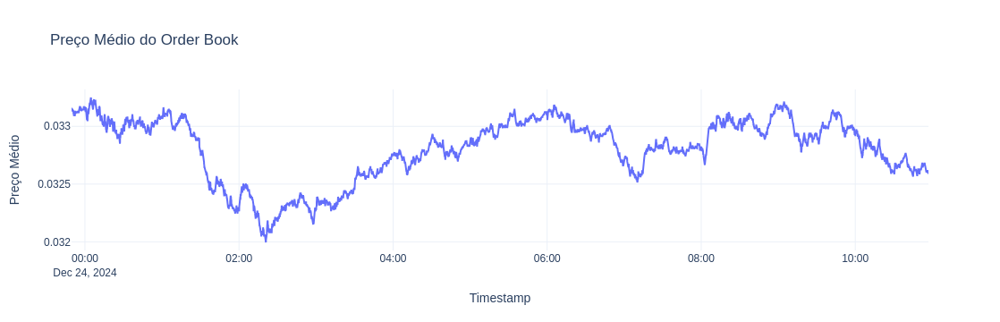

In [356]:
# Criação do gráfico
fig = go.Figure()
fig.add_trace(go.Scatter(x=data['timestamp'], y=data['mid_price'], mode="lines", name="Preço Médio"))

# Configuração do layout
fig.update_layout(
    title="Preço Médio do Order Book",
    xaxis_title="Timestamp",
    yaxis_title="Preço Médio",
    template="plotly_white",
)

# Exibição do gráfico
fig.show()

In [305]:
data.columns

Index(['timestamp', 'bids', 'asks', 'spread', 'total_bids_volume',
       'total_asks_volume', 'volume_imbalance', 'wap_bids', 'wap_asks',
       'spread_change', 'volume_imbalance_change', 'bids_volume_change',
       'asks_volume_change', 'bids_concentration', 'asks_concentration',
       'bids_wall', 'asks_wall', 'top3_bids_volume', 'top3_asks_volume',
       'top3_volume_asymmetry', 'mid_price', 'mid_price_change',
       'depth_price_difference', 'bids_consumption_rate',
       'asks_consumption_rate', 'spread_volatility',
       'volume_imbalance_velocity', 'buy_signal', 'sell_signal',
       'market_direction', 'bids_consumed', 'asks_consumed',
       'bids_consumed_levels', 'asks_consumed_levels', 'bids_velocity',
       'asks_velocity', 'bids_acceleration', 'asks_acceleration',
       'relative_bids_consumption', 'relative_asks_consumption',
       'bids_consumption_time', 'asks_consumption_time'],
      dtype='object')

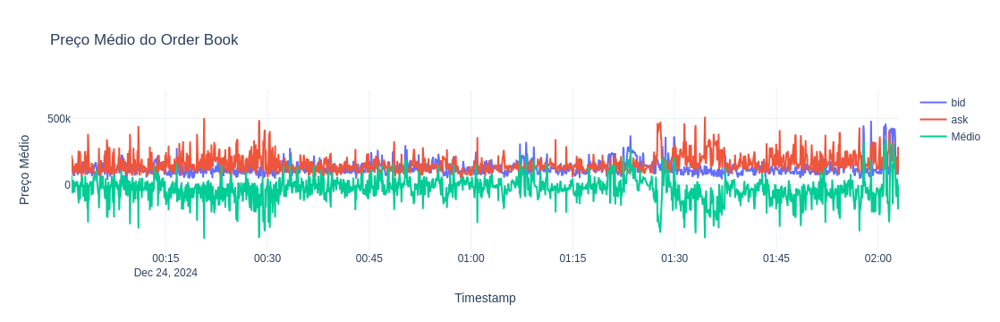

In [308]:
# Criação do gráfico
fig = go.Figure()
fig.add_trace(go.Scatter(x=data['timestamp'], y=data['top3_bids_volume'], mode="lines", name="bid"))
fig.add_trace(go.Scatter(x=data['timestamp'], y=data['top3_asks_volume'], mode="lines", name="ask"))
fig.add_trace(go.Scatter(x=data['timestamp'], y=data['top3_volume_asymmetry'], mode="lines", name="Médio"))

# Configuração do layout
fig.update_layout(
    title="Preço Médio do Order Book",
    xaxis_title="Timestamp",
    yaxis_title="Preço Médio",
    template="plotly_white",
)

# Exibição do gráfico
fig.show()

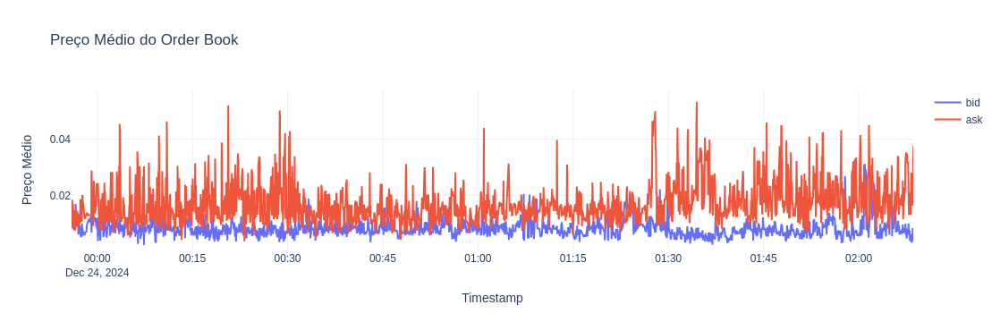

In [310]:
# Criação do gráfico
fig = go.Figure()
fig.add_trace(go.Scatter(x=data['timestamp'], y=data['bids_concentration'], mode="lines", name="bid"))
fig.add_trace(go.Scatter(x=data['timestamp'], y=data['asks_concentration'], mode="lines", name="ask"))

# Configuração do layout
fig.update_layout(
    title="Preço Médio do Order Book",
    xaxis_title="Timestamp",
    yaxis_title="Preço Médio",
    template="plotly_white",
)

# Exibição do gráfico
fig.show()

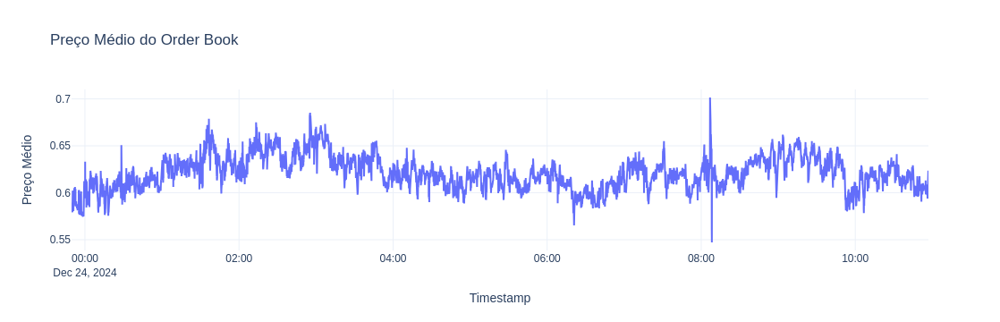

In [311]:
# Criação do gráfico
fig = go.Figure()
fig.add_trace(go.Scatter(x=data['timestamp'], y=data['volume_imbalance'], mode="lines", name="Preço Médio"))

# Configuração do layout
fig.update_layout(
    title="Preço Médio do Order Book",
    xaxis_title="Timestamp",
    yaxis_title="Preço Médio",
    template="plotly_white",
)

# Exibição do gráfico
fig.show()

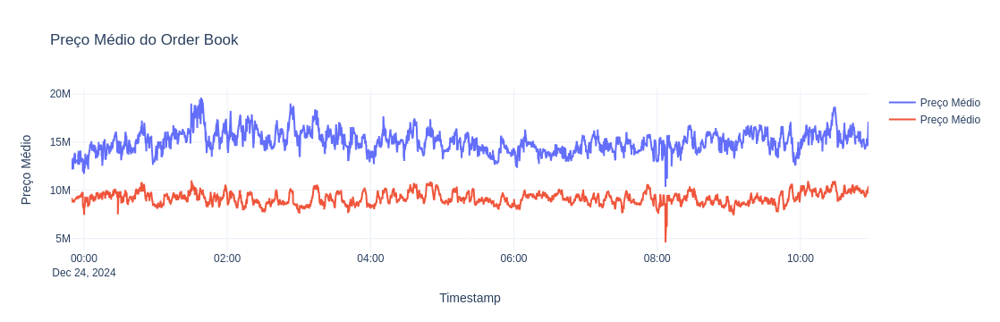

In [312]:
# Criação do gráfico
fig = go.Figure()
fig.add_trace(go.Scatter(x=data['timestamp'], y=data['total_bids_volume'], mode="lines", name="Preço Médio"))
fig.add_trace(go.Scatter(x=data['timestamp'], y=data['total_asks_volume'], mode="lines", name="Preço Médio"))

# Configuração do layout
fig.update_layout(
    title="Preço Médio do Order Book",
    xaxis_title="Timestamp",
    yaxis_title="Preço Médio",
    template="plotly_white",
)

# Exibição do gráfico
fig.show()

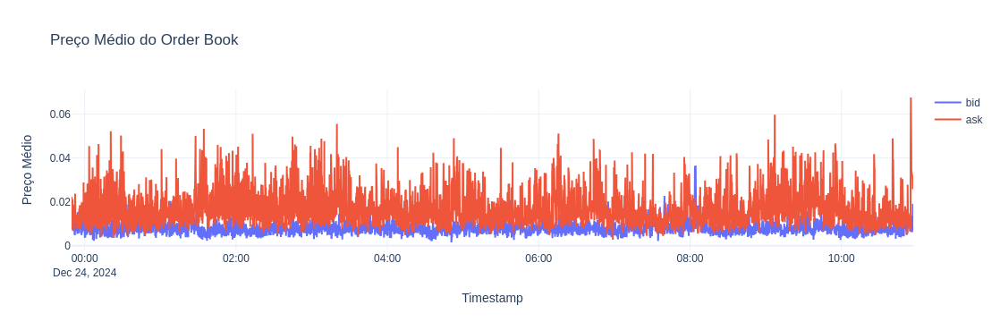

In [314]:
# Criação do gráfico
fig = go.Figure()
fig.add_trace(go.Scatter(x=data['timestamp'], y=data['bids_concentration'], mode="lines", name="bid"))
fig.add_trace(go.Scatter(x=data['timestamp'], y=data['asks_concentration'], mode="lines", name="ask"))

# Configuração do layout
fig.update_layout(
    title="Preço Médio do Order Book",
    xaxis_title="Timestamp",
    yaxis_title="Preço Médio",
    template="plotly_white",
)

# Exibição do gráfico
fig.show()

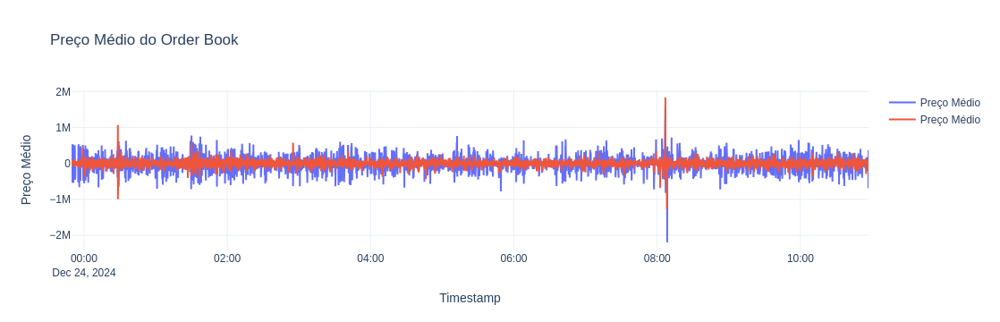

In [315]:
# Criação do gráfico
fig = go.Figure()
fig.add_trace(go.Scatter(x=data['timestamp'], y=data['bids_velocity'], mode="lines", name="Preço Médio"))
fig.add_trace(go.Scatter(x=data['timestamp'], y=data['asks_velocity'], mode="lines", name="Preço Médio"))
# fig.add_trace(go.Scatter(x=data['timestamp'], y=data['bids_acceleration'], mode="lines", name="Preço Médio"))
# fig.add_trace(go.Scatter(x=data['timestamp'], y=data['asks_acceleration'], mode="lines", name="Preço Médio"))
# fig.add_trace(go.Scatter(x=data['timestamp'], y=data['relative_bids_consumption'], mode="lines", name="Preço Médio"))
# fig.add_trace(go.Scatter(x=data['timestamp'], y=data['relative_asks_consumption'], mode="lines", name="Preço Médio"))

# Configuração do layout
fig.update_layout(
    title="Preço Médio do Order Book",
    xaxis_title="Timestamp",
    yaxis_title="Preço Médio",
    template="plotly_white",
)

# Exibição do gráfico
fig.show()

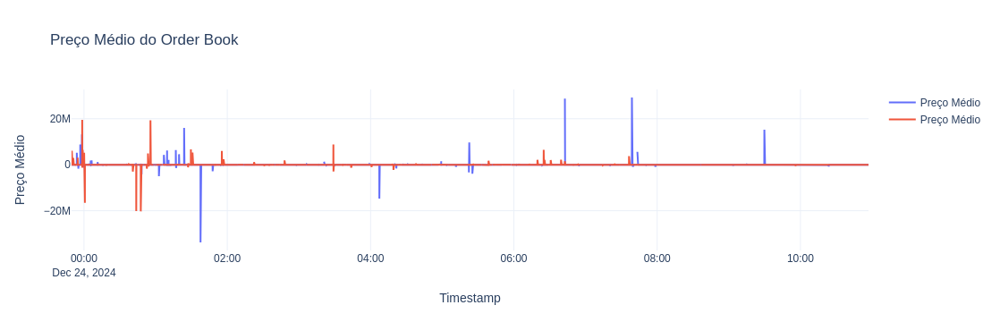

In [316]:
# Criação do gráfico
fig = go.Figure()
fig.add_trace(go.Scatter(x=data['timestamp'], y=data['bids_consumption_time'], mode="lines", name="Preço Médio"))
fig.add_trace(go.Scatter(x=data['timestamp'], y=data['asks_consumption_time'], mode="lines", name="Preço Médio"))

# Configuração do layout
fig.update_layout(
    title="Preço Médio do Order Book",
    xaxis_title="Timestamp",
    yaxis_title="Preço Médio",
    template="plotly_white",
)

# Exibição do gráfico
fig.show()

In [317]:
window = 100  # Número de snapshots para a média móvel

data["smoothed_bids_velocity"] = data["bids_velocity"].rolling(window=window).mean()
data["smoothed_asks_velocity"] = data["asks_velocity"].rolling(window=window).mean()


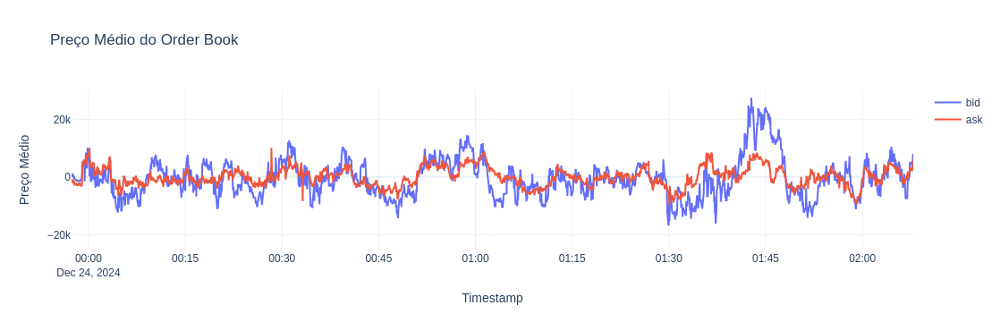

In [318]:
# Criação do gráfico
fig = go.Figure()
fig.add_trace(go.Scatter(x=data['timestamp'], y=data['smoothed_bids_velocity'], mode="lines", name="bid"))
fig.add_trace(go.Scatter(x=data['timestamp'], y=data['smoothed_asks_velocity'], mode="lines", name="ask"))

# Configuração do layout
fig.update_layout(
    title="Preço Médio do Order Book",
    xaxis_title="Timestamp",
    yaxis_title="Preço Médio",
    template="plotly_white",
)

# Exibição do gráfico
fig.show()

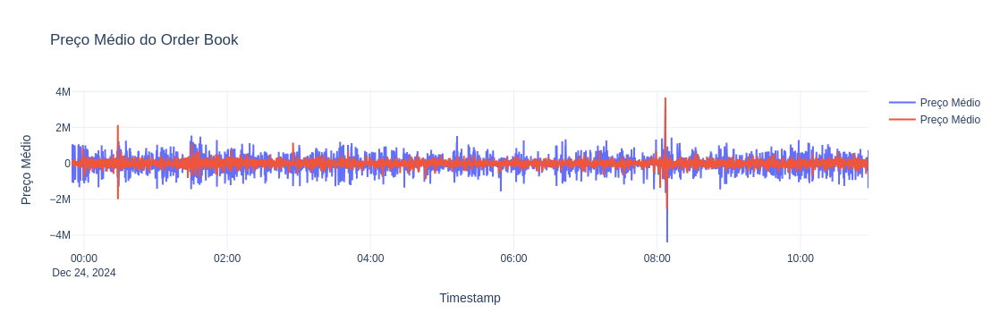

In [319]:
# Criação do gráfico
fig = go.Figure()
fig.add_trace(go.Scatter(x=data['timestamp'], y=data['bids_consumed_levels'], mode="lines", name="Preço Médio"))
fig.add_trace(go.Scatter(x=data['timestamp'], y=data['asks_consumed_levels'], mode="lines", name="Preço Médio"))

# Configuração do layout
fig.update_layout(
    title="Preço Médio do Order Book",
    xaxis_title="Timestamp",
    yaxis_title="Preço Médio",
    template="plotly_white",
)

# Exibição do gráfico
fig.show()

In [320]:
# Classificar velocidade como positiva ou negativa
data["bids_trend"] = data["smoothed_bids_velocity"].apply(lambda x: "positive" if x > 0 else "negative")
data["asks_trend"] = data["smoothed_asks_velocity"].apply(lambda x: "positive" if x > 0 else "negative")


def calculate_persistence(trend_column):
    persistence = []
    counter = 0
    previous_trend = None

    for trend in trend_column:
        if trend == previous_trend:
            counter += 1
        else:
            counter = 1  # Reinicia o contador quando a tendência muda
        persistence.append(counter)
        previous_trend = trend

    return persistence

data["bids_persistence"] = calculate_persistence(data["bids_trend"])
data["asks_persistence"] = calculate_persistence(data["asks_trend"])


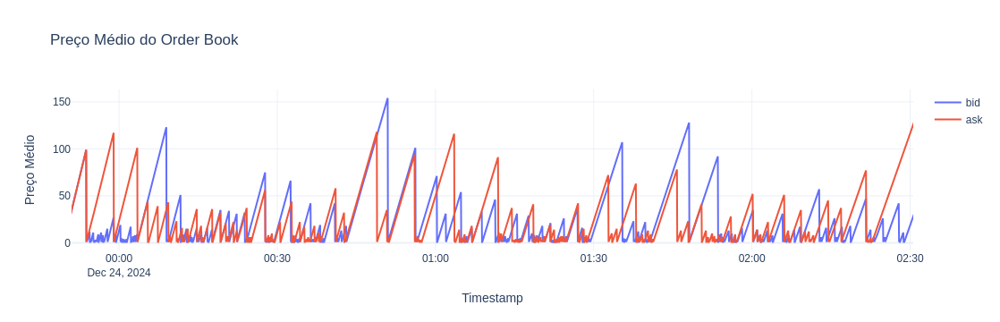

In [321]:
# Criação do gráfico
fig = go.Figure()
fig.add_trace(go.Scatter(x=data['timestamp'], y=data['bids_persistence'], mode="lines", name="bid"))
fig.add_trace(go.Scatter(x=data['timestamp'], y=data['asks_persistence'], mode="lines", name="ask"))

# Configuração do layout
fig.update_layout(
    title="Preço Médio do Order Book",
    xaxis_title="Timestamp",
    yaxis_title="Preço Médio",
    template="plotly_white",
)

# Exibição do gráfico
fig.show()

In [322]:
data["smoothed_bids_acceleration"] = data["smoothed_bids_velocity"].diff()
data["smoothed_asks_acceleration"] = data["smoothed_asks_velocity"].diff()


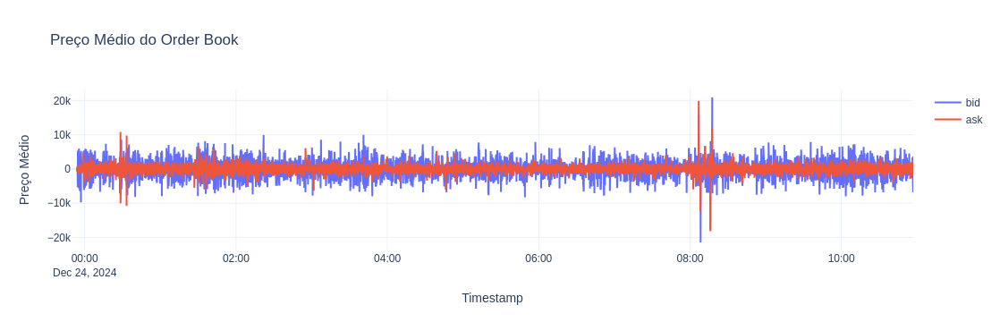

In [323]:
# Criação do gráfico
fig = go.Figure()
fig.add_trace(go.Scatter(x=data['timestamp'], y=data['smoothed_bids_acceleration'], mode="lines", name="bid"))
fig.add_trace(go.Scatter(x=data['timestamp'], y=data['smoothed_asks_acceleration'], mode="lines", name="ask"))

# Configuração do layout
fig.update_layout(
    title="Preço Médio do Order Book",
    xaxis_title="Timestamp",
    yaxis_title="Preço Médio",
    template="plotly_white",
)

# Exibição do gráfico
fig.show()

In [357]:
# Desequilíbrio de volume: Proporção entre bids e asks
data["volume_imbalance"] = data["total_bids_volume"] / (data["total_bids_volume"] + data["total_asks_volume"])

# Suavizar a velocidade de consumo
window = 500  # Número de snapshots para suavização
data["smoothed_bids_velocity"] = data["bids_velocity"].rolling(window=window).mean()
data["smoothed_asks_velocity"] = data["asks_velocity"].rolling(window=window).mean()

# Direção do mercado baseada no desequilíbrio e consumo
data["market_direction"] = (
    data["volume_imbalance"] - 0.5  # Neutraliza o desequilíbrio para indicar direção
    + (data["smoothed_bids_velocity"] - data["smoothed_asks_velocity"]) / 2  # Consumo relativo
)


data["smoothed_direction"] = data["market_direction"].rolling(window=20).mean()


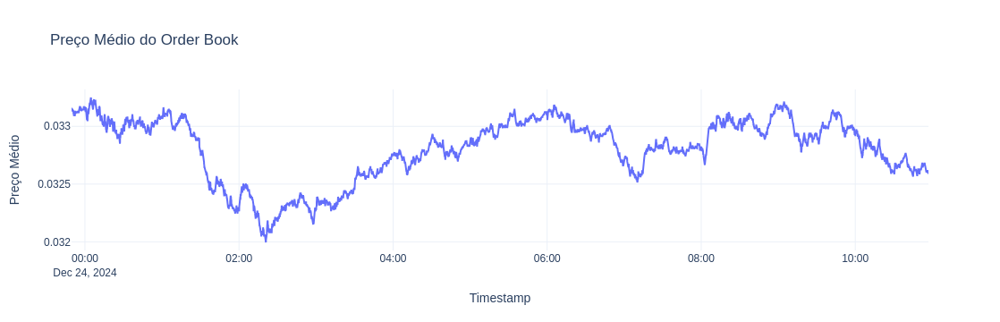

In [358]:
# Criação do gráfico
fig = go.Figure()
fig.add_trace(go.Scatter(x=data['timestamp'], y=data['mid_price'], mode="lines", name="Preço Médio"))

# Configuração do layout
fig.update_layout(
    title="Preço Médio do Order Book",
    xaxis_title="Timestamp",
    yaxis_title="Preço Médio",
    template="plotly_white",
)

# Exibição do gráfico
fig.show()

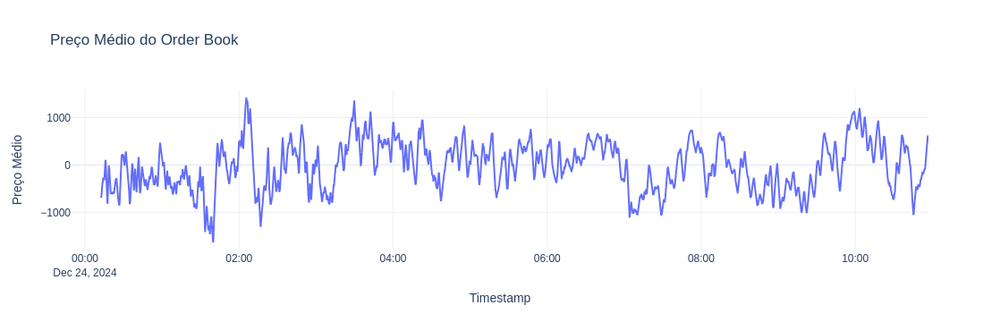

In [359]:
# Criação do gráfico
fig = go.Figure()
fig.add_trace(go.Scatter(x=data['timestamp'], y=data['smoothed_direction'], mode="lines", name="bid"))

# Configuração do layout
fig.update_layout(
    title="Preço Médio do Order Book",
    xaxis_title="Timestamp",
    yaxis_title="Preço Médio",
    template="plotly_white",
)

# Exibição do gráfico
fig.show()


In [360]:
import numpy as np

In [361]:
window = 200  # Número de snapshots na janela (20 segundos)
# Volume consumido acumulado
data["bids_consumed_cumulative"] = data["bids_consumed"].rolling(window=window).sum()
data["asks_consumed_cumulative"] = data["asks_consumed"].rolling(window=window).sum()

# Desequilíbrio médio acumulado
data["volume_imbalance_avg"] = data["volume_imbalance"].rolling(window=window).mean()

# Função de suavização ponderada
def weighted_average(series, weights):
    return (series * weights).sum() / weights.sum()

weights = np.linspace(1, window, window)  # Pesos crescentes
data["weighted_bids_velocity"] = data["bids_velocity"].rolling(window=window).apply(
    lambda x: weighted_average(x, weights), raw=False
)
data["weighted_asks_velocity"] = data["asks_velocity"].rolling(window=window).apply(
    lambda x: weighted_average(x, weights), raw=False
)

# Indicador final (velocidade agregada normalizada)
data["final_indicator"] = (
    (data["bids_consumed_cumulative"] - data["asks_consumed_cumulative"])  # Consumo acumulado
    + (data["weighted_bids_velocity"] - data["weighted_asks_velocity"])  # Velocidade ponderada
    + (data["volume_imbalance_avg"] - 0.5)  # Desequilíbrio médio
)


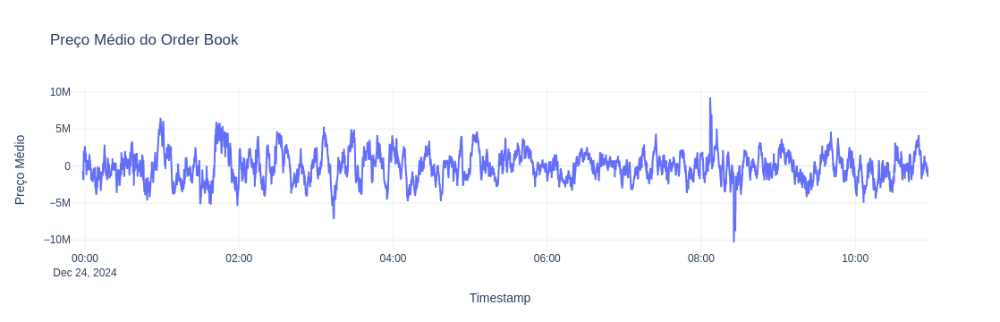

In [362]:
# Criação do gráfico
fig = go.Figure()
fig.add_trace(go.Scatter(x=data['timestamp'], y=data['final_indicator'], mode="lines", name="bid"))

# Configuração do layout
fig.update_layout(
    title="Preço Médio do Order Book",
    xaxis_title="Timestamp",
    yaxis_title="Preço Médio",
    template="plotly_white",
)

# Exibição do gráfico
fig.show()

In [365]:
window = 500  # Tamanho da janela deslizante

# Acumulador real para consumo de bids e asks
data["bids_consumed_accum"] = data["bids_consumed"].rolling(window=window).sum()
data["asks_consumed_accum"] = data["asks_consumed"].rolling(window=window).sum()

# Acumulador real para desequilíbrio médio
data["volume_imbalance_accum"] = data["volume_imbalance"].rolling(window=window).sum()

# Indicador final baseado em acumuladores
data["final_indicator_accum"] = (
    data["bids_consumed_accum"] - data["asks_consumed_accum"]  # Consumo acumulado
    + (data["volume_imbalance_accum"] / window - 0.5)  # Desequilíbrio acumulado médio normalizado
)



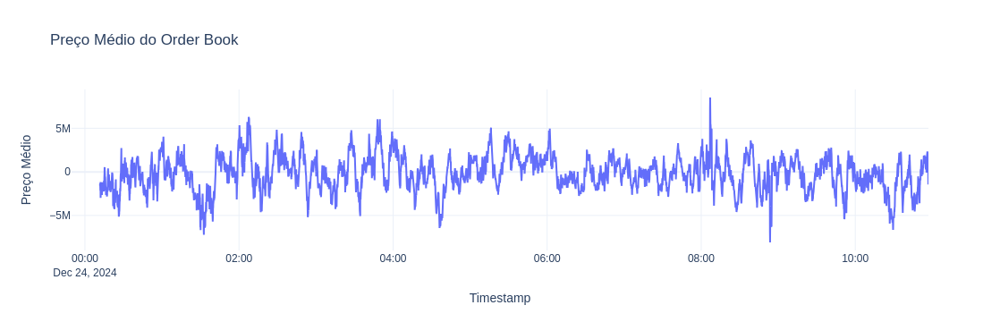

In [366]:
# Criação do gráfico
fig = go.Figure()
fig.add_trace(go.Scatter(x=data['timestamp'], y=data['final_indicator_accum'], mode="lines", name="bid"))

# Configuração do layout
fig.update_layout(
    title="Preço Médio do Order Book",
    xaxis_title="Timestamp",
    yaxis_title="Preço Médio",
    template="plotly_white",
)

# Exibição do gráfico
fig.show()

In [367]:
def calculate_consumption(snapshot_prev, snapshot_curr):
    bids_consumed = 0
    asks_consumed = 0

    # Consumo de bids
    for prev, curr in zip(snapshot_prev["bids"], snapshot_curr["bids"]):
        prev_volume = float(prev[1])
        curr_volume = float(curr[1])
        if curr_volume < prev_volume:  # Volume diminuiu
            bids_consumed += prev_volume - curr_volume

    # Consumo de asks
    for prev, curr in zip(snapshot_prev["asks"], snapshot_curr["asks"]):
        prev_volume = float(prev[1])
        curr_volume = float(curr[1])
        if curr_volume < prev_volume:  # Volume diminuiu
            asks_consumed += prev_volume - curr_volume

    return bids_consumed, asks_consumed

# Aplicar o cálculo em todos os snapshots
bids_consumed = []
asks_consumed = []

for i in range(1, len(snapshots)):
    bids, asks = calculate_consumption(snapshots[i - 1], snapshots[i])
    bids_consumed.append(bids)
    asks_consumed.append(asks)

# Adicionar os resultados ao DataFrame
data["bids_consumed"] = [0] + bids_consumed  # Primeiro snapshot não tem consumo
data["asks_consumed"] = [0] + asks_consumed


# Consumo acumulado
data["bids_consumed_cumulative"] = data["bids_consumed"].cumsum()
data["asks_consumed_cumulative"] = data["asks_consumed"].cumsum()


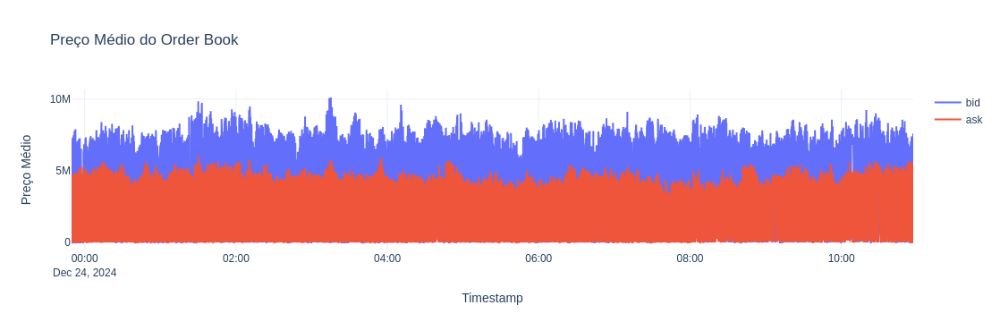

In [369]:
# Criação do gráfico
fig = go.Figure()
fig.add_trace(go.Scatter(x=data['timestamp'], y=data['bids_consumed'], mode="lines", name="bid"))
fig.add_trace(go.Scatter(x=data['timestamp'], y=data['asks_consumed'], mode="lines", name="ask"))

# Configuração do layout
fig.update_layout(
    title="Preço Médio do Order Book",
    xaxis_title="Timestamp",
    yaxis_title="Preço Médio",
    template="plotly_white",
)

# Exibição do gráfico
fig.show()

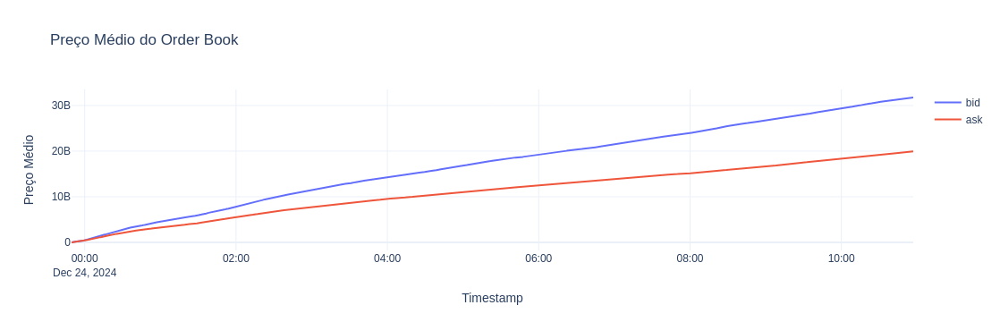

In [370]:
# Criação do gráfico
fig = go.Figure()
fig.add_trace(go.Scatter(x=data['timestamp'], y=data['bids_consumed_cumulative'], mode="lines", name="bid"))
fig.add_trace(go.Scatter(x=data['timestamp'], y=data['asks_consumed_cumulative'], mode="lines", name="ask"))

# Configuração do layout
fig.update_layout(
    title="Preço Médio do Order Book",
    xaxis_title="Timestamp",
    yaxis_title="Preço Médio",
    template="plotly_white",
)

# Exibição do gráfico
fig.show()

In [381]:
def calculate_level_consumption(snapshot_prev, snapshot_curr):
    bids_consumed_levels = []
    asks_consumed_levels = []

    # Calcular consumo de bids por nível
    for prev, curr in zip(snapshot_prev["bids"], snapshot_curr["bids"]):
        prev_volume = float(prev[1])
        curr_volume = float(curr[1])
        bids_consumed_levels.append(max(0, prev_volume - curr_volume))  # Apenas consumo positivo

    # Calcular consumo de asks por nível
    for prev, curr in zip(snapshot_prev["asks"], snapshot_curr["asks"]):
        prev_volume = float(prev[1])
        curr_volume = float(curr[1])
        asks_consumed_levels.append(max(0, prev_volume - curr_volume))  # Apenas consumo positivo

    return bids_consumed_levels, asks_consumed_levels

# Aplicar o cálculo em todos os snapshots
bids_consumed_levels_all = []
asks_consumed_levels_all = []

for i in range(1, len(snapshots)):
    bids_levels, asks_levels = calculate_level_consumption(snapshots[i - 1], snapshots[i])
    bids_consumed_levels_all.append(bids_levels)
    asks_consumed_levels_all.append(asks_levels)

# Adicionar resultados ao DataFrame
for level in range(99):
    data[f"bids_consumed_level_{level+1}"] = [0] + [bids[level] for bids in bids_consumed_levels_all]
    data[f"asks_consumed_level_{level+1}"] = [0] + [asks[level] for asks in asks_consumed_levels_all]


In [391]:
# Consumo acumulado por nível
for level in range(99):
    data[f"bids_consumed_cumulative_level_{level+1}"] = data[f"bids_consumed_level_{level+1}"].cumsum()
    data[f"asks_consumed_cumulative_level_{level+1}"] = data[f"asks_consumed_level_{level+1}"].cumsum()


# Consumo médio instantâneo
data["bids_consumed_mean"] = data[[f"bids_consumed_level_{level+1}" for level in range(99)]].mean(axis=1)
data["asks_consumed_mean"] = data[[f"asks_consumed_level_{level+1}" for level in range(99)]].mean(axis=1)

# Consumo acumulado médio
data["bids_consumed_cumulative_mean"] = data[[f"bids_consumed_cumulative_level_{level+1}" for level in range(30)]].mean(axis=1)
data["asks_consumed_cumulative_mean"] = data[[f"asks_consumed_cumulative_level_{level+1}" for level in range(30)]].mean(axis=1)


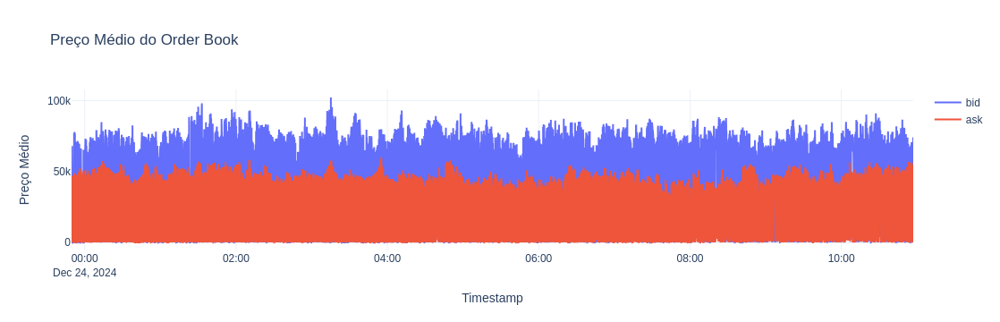

In [392]:
# Criação do gráfico
fig = go.Figure()
fig.add_trace(go.Scatter(x=data['timestamp'], y=data['bids_consumed_mean'], mode="lines", name="bid"))
fig.add_trace(go.Scatter(x=data['timestamp'], y=data['asks_consumed_mean'], mode="lines", name="ask"))

# Configuração do layout
fig.update_layout(
    title="Preço Médio do Order Book",
    xaxis_title="Timestamp",
    yaxis_title="Preço Médio",
    template="plotly_white",
)

# Exibição do gráfico
fig.show()

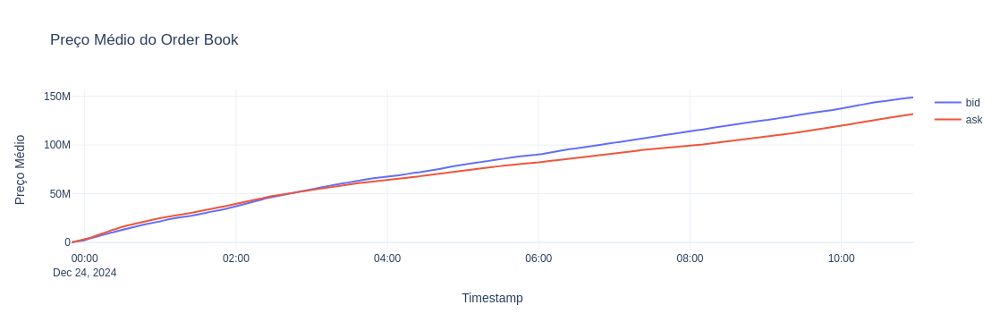

In [393]:
# Criação do gráfico
fig = go.Figure()
fig.add_trace(go.Scatter(x=data['timestamp'], y=data['bids_consumed_cumulative_mean'], mode="lines", name="bid"))
fig.add_trace(go.Scatter(x=data['timestamp'], y=data['asks_consumed_cumulative_mean'], mode="lines", name="ask"))

# Configuração do layout
fig.update_layout(
    title="Preço Médio do Order Book",
    xaxis_title="Timestamp",
    yaxis_title="Preço Médio",
    template="plotly_white",
)

# Exibição do gráfico
fig.show()